# Exercice Python OOP : Dunjeons & Dragons 

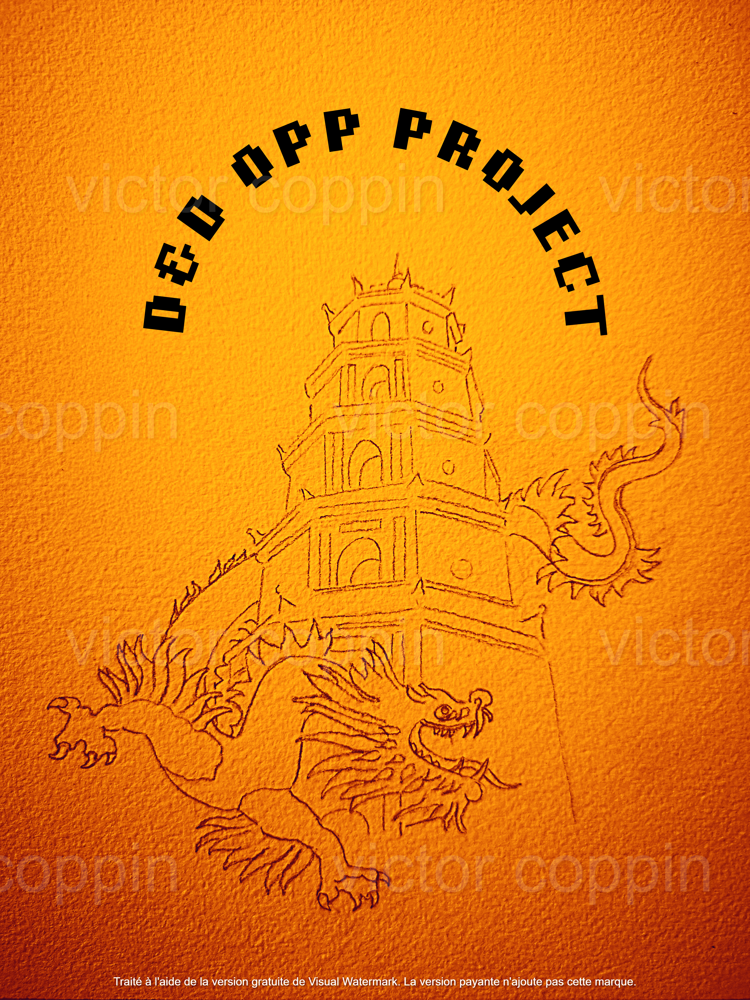

## Creation de personnages inspire de l'univers de Dungeons and Dragons 

Les personnages du jeu ont les caracteristiques du tableau suivant selon la race et le genre.
A ces caracteristique, les types ajoutes des bonus :
Barbares + 2 en force
Guerrier + 1 point de vie
Magicien + 2 en sagesse
Un elf barbare homme aura donc 7 de force, 7 de sagesse et 6 points de vie

|            | Humans        |          | Elves         |          | Dwarves       |          | Orcs          |          | Goblins       |          |
|------------|---------------|----------|---------------|----------|---------------|----------|---------------|----------|---------------|----------|
|            | Man           | Woman    | Man           | Woman    | Man           | Woman    | None           | None    |
| Strength   | 6             | 5        | 5             | 4        | 7             | 6        | 6             | 4        |
| Wisdom     | 5             | 6        | 7             | 8       | 6             | 7        | 0             | 0        |
| Points of Life | 5        | 5        | 6             | 6        | 7             | 7        | 10             | 4        |


Abstract class "Character"
Cette classe est utilise comme interface

In [21]:
import random as rd
from tabulate import tabulate
from abc import ABC,abstractmethod

class Character(ABC):
  '''
  Définition de la classe personnage qui regroupe les personnages jouables par le joueur et les ennemis du jeu
  Paramètres:
  >category: 2 catégories possibles, les héros (heros) incarnés par le joueur et les ennemies (ennemies)
  >species: humains(humans), elfs(elfes), nains(dwarves), monstres(monsters)
  >class_type:
  les humains, elfs et nains peuvent faire parti des sous-classes magiciens, barbare et guerrier,
  les ennemies sont de la classe orcs ou gobelins
  >gender: homme ou femme disponible uniquement pour les héros
  >name: nom choisi par le joueur
  >age:age choisi par le joueur, impact la force et la sagesse
  >level: tous les personnages ont un niveau de départ à 0, le niveau augmente en fonction du nombre d'ennemis vaincus
  '''
  #attribut de class
  default_settings_points = 5
  default_setting_dice = 1

  def __init__(self,gender,name = 'default_name',age = 30):

    # Genre
    if gender not in ['man','woman','not-defined']:
      raise ValueError("le genre doit être 'man' ou 'woman' ou " 'not-defined')
    self.gender = gender
    self.name = name
    self.age = age
    '''
    Les attributs suivants sont par défaut à 5 points
    Les class espèce et l'âge modifie ces attributs
    '''
    #Points de vie
    self.__point_of_life = Character.default_settings_points
    #Force et Sagesse
    self.__strenght = Character.default_settings_points
    self.__wisdom = Character.default_settings_points
    #Modification de la force et sagesse en fonction du genre
    if self.gender == 'man':
      self.__strenght += 1

    if self.gender == 'woman':
      self.__wisdom += 1
    self.__movement = Character.default_setting_dice

  # Methodes pour les accesseurs

  def get_point_of_life(self):
    return self.__point_of_life
  def set_point_of_life(self,point_of_life):
    self.__point_of_life = point_of_life

  def get_wisdom(self):
    return self.__wisdom
  def set_wisdom(self,wisdom):
    self.__wisdom = wisdom

  def get_strenght(self):
    return self.__strenght
  def set_strenght(self,strenght):
    self.__strenght = strenght

  def get_movement(self):
    return self.__movement

  def character_sheet(self):
    print(self.name + ' ' + self.gender)
    charsheet = [[self.__point_of_life,self.__wisdom,self.__strenght,self.__movement]]
    print(tabulate(charsheet,headers= ['life','wisdom','strenght','movement']))

  #Actions

  def move(self):
    return rd.randrange(1,6,1)

  def take(self,item):
    print("You take " + item)

  #Methode abstraite
  @abstractmethod
  def jump(self):
    print("jump")


Classe Abstraite Capacite_type
Cette classe est utilise comme interface

In [23]:
from abc import ABC,abstractmethod
"""
Classes abstraites Capacite_type
Utilisation pour creer une interface : Charactere + Capacite_type
"""
class Capacite_Barbare(ABC):
  @abstractmethod
  def melee_attack(self):
    print("You attack with a melee weapon")
  @abstractmethod
  def dodge(self):
    print("You dodge a blow")


class Capacite_Warrior(ABC):
  def melee_attack(self):
    print("You attack with a melee weapon")
  def wear_armor(self):
    print("You wear an armor")
  def wear_shield(self):
    print("You wear a shield")
  def block_attack(self):
    print("You block the attack")


class Capacite_Wizard(ABC):
  def magic_attack(self):
    print("You cast a spell")
  def dodge(self):
    print("You dodge a blow")


### Les classes de type : Race_type sont construite a partir des interfaces Character et Capacite

Définition d'une sous-classe barbare humain

In [32]:
class Human_Barbarian(Character,Capacite_Barbare):
  '''
  Définition d'une sous-classe barbare humain
  '''

  def __init__(self,gender,name = 'default_name',age = 30):
    super().__init__(gender,name,age)
    super().set_strenght(super().get_strenght()+2)


  def take(self,item):
    if item == "Armor" or "Shield":
      print("You can't take " + item)
    else:
      print("You take " + item)

  def character_sheet(self):
    print( 'Humain de type Barbare')
    super().character_sheet()
  def jump(self):
    print('jump1')

  def melee_attack(self):
    print("You attack with a melee weapon")

  def dodge(self):
    print("You dodge a blow")

Définition d'une sous-classe Elf_Barbarian

In [30]:
class Elf_Barbarian(Character,Capacite_Barbare):
  '''
  Définition d'une sous-classe barbare humain
  '''

  def __init__(self,gender,name = 'default_name',age = 30):
    super().__init__(gender,name,age)
    super().set_strenght(super().get_strenght()+1)
    super().set_wisdom(super().get_wisdom()+2)
    super().set_point_of_life(super().get_point_of_life()+1)

  def take(self,item):
    if item == "Armor" or "Shield":
      print("You can't take " + item)
    else:
      print("You take " + item)

  def character_sheet(self):
    print( 'Elf de type Barbare')
    super().character_sheet()
  def jump(self):
    print('jump2')

  def melee_attack(self):
    print("You attack with a melee weapon")

  def dodge(self):
    print("You dodge a blow")


Définition d'une sous-classe Elf_Wizard

In [40]:
class Elf_Wizard(Character,Capacite_Wizard):
  '''
  Définition d'une sous-classe elf
  La classe elf est un objet Personnage (Character) Héro qui possede un mouvement de + 3

  '''
  def __init__(self,gender,name = 'default_name',age = 30):
    super().__init__(gender,name,age)
    super().set_strenght(super().get_strenght()-1)
    super().set_wisdom(super().get_wisdom()+4)
    super().set_point_of_life(super().get_point_of_life()+1)
  def character_sheet(self):
    print('Elf Wizard')
    super().character_sheet()
  def jump(self):
    print('jump2')
  def magic_attack(self):
    print("You cast a spell")
  def dodge(self):
    print("You dodge a blow")



Définition d'une sous-classe Dwarf

In [38]:
class Dwarf(Character,ABC):
  '''
  Définition d'une sous-classe Nain
  La classe Naim est un objet Personnage (Character) Héro qui possede un mouvement de + 3

  '''
  def __init__(self,gender,name = 'default_name',age = 30):
    super().__init__(gender,name,age)
    super().set_strenght(super().get_strenght()+2)
    super().set_wisdom(super().get_wisdom()+1)
    super().set_point_of_life(super().get_point_of_life()+2)

  def character_sheet(self):
    print('Dwarf')
    super().character_sheet()
  def jump(self):
    print('jump0')

In [46]:
if __name__ == "__main__":
    ch1= Human_Barbarian('man','Vic',30)
    ch1.character_sheet()
    
    print(ch1.move())
    ch1.jump()
    ch1.take("Armor")
    ch1.dodge()
    
    ch2 = Elf_Barbarian('woman', 'Nelly',30)
    ch2.character_sheet()
    ch2.dodge()
    
    ch3 = Elf_Wizard("man","Hanna",230)
    ch3.character_sheet()
    
    ch3.magic_attack()

Humain de type Barbare
Vic man
  life    wisdom    strenght    movement
------  --------  ----------  ----------
     5         5           8           1
3
jump1
You can't take Armor
You dodge a blow
Elf de type Barbare
Nelly woman
  life    wisdom    strenght    movement
------  --------  ----------  ----------
     6         8           6           1
You dodge a blow
Elf Wizard
Hanna man
  life    wisdom    strenght    movement
------  --------  ----------  ----------
     6         9           5           1
You cast a spell
